# Comparison of default run to ILAMB observations

# 1. Setup

In [1]:
%load_ext watermark

from glob import glob

import numpy as np
import pandas as pd
import xarray as xr
import cftime

from ILAMB import ilamblib
import regionmask as rgn

import matplotlib as mpl
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cmocean.cm as cmo

%watermark -iv -co -v

Python implementation: CPython
Python version       : 3.12.9
IPython version      : 9.0.2

conda environment: ilamb

cftime    : 1.6.4
ILAMB     : 2.7.2
pandas    : 2.2.2
matplotlib: 3.10.1
xarray    : 2025.3.0
sys       : 3.12.9 | packaged by conda-forge | (main, Mar  4 2025, 22:48:41) [GCC 13.3.0]
cmocean   : 4.0.3
cartopy   : 0.24.0
numpy     : 2.2.4
regionmask: 0.13.0



In [2]:
xr.set_options(display_expand_attrs=False, display_expand_data=False);

# 2. Load annual mean ILAMB datasets

## 2.1. LAI

In [11]:
indir = '/glade/work/bbuchovecky/CPL_PPE_CO2/select_parameters/ILAMB_data/processed/annual_mean'

lai_avh15c1 = xr.open_dataset(f'{indir}/LAI_ANNUAL_AVH15C1_ILAMB_20250709.nc')
lai_avhrr = xr.open_dataset(f'{indir}/LAI_ANNUAL_AVHRR_ILAMB_20250709.nc')
lai_cao2023 = xr.open_dataset(f'{indir}/LAI_ANNUAL_CAO2023_ILAMB_20250709.nc')
lai_modis = xr.open_dataset(f'{indir}/LAI_ANNUAL_MODIS_ILAMB_20250709.nc')

lai = {
    'AVH15C1': lai_avh15c1,
    'AVHRR': lai_avhrr,
    'CAO2023': lai_cao2023,
    'MODIS': lai_modis,
}

# Load the land mask from the Natural Earth dataset
land = rgn.defined_regions.natural_earth_v5_1_2.land_50

# Compute the cell areas for each dataset then extract the LAI variable
area = {}
lnd_area = {}
for key, ds in lai.items():
    print(key)

    if 'lat_bounds' in ds and 'lon_bounds' in ds:
        print('  using bounds')
        method = 'bounds'
        lat_bounds = ds['lat_bounds'].values
        lon_bounds = ds['lon_bounds'].values
    else:
        print('  could not find bounds, using coordinates instead')
        method = 'coords'
        lat_bounds = None
        lon_bounds = None

    # Compute the cell areas using the ILAMB function
    area[key] = ilamblib.CellAreas(
                    lat=ds['lat'].values,
                    lon=ds['lon'].values,
                    lat_bnds=lat_bounds,
                    lon_bnds=lon_bounds,
                )

    area[key] = xr.DataArray(area[key], dims=['lat', 'lon'], coords={'lat': ds['lat'], 'lon': ds['lon']})
    area[key].attrs['units'] = 'm2'
    area[key].attrs['long_name'] = 'grid cell area'
    area[key].attrs['method'] = method

    # Create a land mask for the dataset using the Natural Earth land mask
    lnd_mask = xr.where(np.isnan(land.mask(lon_or_obj=area[key].lon, lat=area[key].lat)), 0, 1)
    lnd_area[key] = area[key] * lnd_mask
    lnd_area[key].attrs['units'] = 'm2'
    lnd_area[key].attrs['long_name'] = 'land grid cell area'
    lnd_area[key].attrs['method'] = method

    # Extract the LAI variable from each dataset
    lai[key] = ds['lai'].where(lnd_mask > 0)

AVH15C1
  using bounds
AVHRR
  could not find bounds, using coordinates instead
CAO2023
  could not find bounds, using coordinates instead
MODIS
  could not find bounds, using coordinates instead


## 2.2. ET

In [12]:
indir = '/glade/work/bbuchovecky/CPL_PPE_CO2/select_parameters/ILAMB_data/processed/annual_mean'

et_gleam = xr.open_dataset(f'{indir}/HFLS_ANNUAL_GLEAMv3.3a_ILAMB_20250320.nc')
et_mod16a2 = xr.open_dataset(f'{indir}/HFLS_ANNUAL_MOD16A2_ILAMB_20250320.nc')
et_modis = xr.open_dataset(f'{indir}/HFLS_ANNUAL_MODIS_ILAMB_20250320.nc')
et_dolce = xr.open_dataset(f'{indir}/HFLS_ANNUAL_DOLCE_ILAMB_20250320.nc')
et_class = xr.open_dataset(f'{indir}/HFLS_ANNUAL_CLASS_ILAMB_20250320.nc')
et_wecann = xr.open_dataset(f'{indir}/HFLS_ANNUAL_WECANN_ILAMB_20250320.nc')
et_fluxcom = xr.open_dataset(f'{indir}/HFLS_ANNUAL_FLUXCOM_ILAMB_20250320.nc')

et = {
    'GLEAM': et_gleam,
    'MOD16A2': et_mod16a2,
    'MODIS': et_modis,
    'DOLCE': et_dolce,
    'CLASS': et_class,
    'WECANN': et_wecann.isel(lat=slice(None, None, -1)),  # flip the lat dimension for WECANN
    'FLUXCOM': et_fluxcom
}

# Load the land mask from the Natural Earth dataset
land = rgn.defined_regions.natural_earth_v5_1_2.land_50

# Compute the cell areas for each dataset then extract the ET variable
# area = {}
# lnd_area = {}
for key, ds in et.items():
    print(key)

    if 'lat_bounds' in ds and 'lon_bounds' in ds:
        print('  using bounds')
        method = 'bounds'
        lat_bounds = ds['lat_bounds'].values
        lon_bounds = ds['lon_bounds'].values
    else:
        print('  could not find bounds, using coordinates instead')
        method = 'coords'
        lat_bounds = None
        lon_bounds = None

    # Compute the cell areas using the ILAMB function
    area[key] = ilamblib.CellAreas(
                    lat=ds['lat'].values,
                    lon=ds['lon'].values,
                    lat_bnds=lat_bounds,
                    lon_bnds=lon_bounds,
                )

    area[key] = xr.DataArray(area[key], dims=['lat', 'lon'], coords={'lat': ds['lat'], 'lon': ds['lon']})
    area[key].attrs['units'] = 'm2'
    area[key].attrs['long_name'] = 'grid cell area'
    area[key].attrs['method'] = method
    
    # Create a land mask for the dataset using the Natural Earth land mask
    lnd_mask = xr.where(np.isnan(land.mask(lon_or_obj=area[key].lon, lat=area[key].lat)), 0, 1)
    lnd_area[key] = area[key] * lnd_mask
    lnd_area[key].attrs['units'] = 'm2'
    lnd_area[key].attrs['long_name'] = 'land grid cell area'
    lnd_area[key].attrs['method'] = method

    # Extract the ET (hfls, latent heat flux) variable from each dataset
    et[key] = ds['hfls'].where(lnd_mask > 0)

GLEAM
  using bounds
MOD16A2
  using bounds
MODIS
  could not find bounds, using coordinates instead
DOLCE
  could not find bounds, using coordinates instead
CLASS
  could not find bounds, using coordinates instead
WECANN
  could not find bounds, using coordinates instead
FLUXCOM
  using bounds


# 3. Compute temporal, zonal, and gridded means

In [5]:
start_year = 2000
end_year = 2005
year_slice = slice(start_year, end_year)

## 3.1. LAI

In [13]:
print(f'{start_year} to {end_year}')

ilat = lai['AVH15C1'].lat.values  # use the lat values from AVH15C1 for interpolation

lai_savg = {}
lai_zavg = {}
lai_izavg = {}

# Full temporal averages (all years for each dataset)
lai_tavg_full = {}
lai_tzavg_full = {}
lai_itzavg_full = {}

# Temporal averages for the specified year range (overlapping time period only)
lai_tavg_overlap = {}
lai_tzavg_overlap = {}
lai_itzavg_overlap = {}

for key in lai.keys():
    # Compute the global average
    lai_savg[key] = (lai[key] * lnd_area[key]).sum(dim=['lat', 'lon']) / lnd_area[key].sum(dim=['lat', 'lon'])

    # Compute the zonal averages
    lai_zavg[key] = lai[key].mean(dim='lon')

    # Interpolate the zonal average to a 1deg lat grid
    lai_izavg[key] = lai_zavg[key].interp(lat=ilat, method='linear')

    # Compute the temporal average for the full dataset
    lai_tavg_full[key] = lai[key].mean(dim='year')
    lai_tzavg_full[key] = lai_tavg_full[key].mean(dim='lon')
    lai_itzavg_full[key] = lai_tzavg_full[key].interp(lat=ilat, method='linear')
    
    # Compute the temporal average for the specified year range
    if (start_year in lai[key].year) and (end_year in lai[key].year):
        lai_tavg_overlap[key] = lai[key].sel(year=year_slice).mean(dim='year')

        # Compute the temporal and zonal average
        lai_tzavg_overlap[key] = lai_tavg_overlap[key].mean(dim='lon')
        lai_itzavg_overlap[key] = lai_tzavg_overlap[key].interp(lat=ilat, method='linear')
    else:
        print('skipping temporal average for', key)

# Create a DataArray from the lai_itzavg_overlap dictionary
datasets = list(lai_itzavg_overlap.keys())
data = [lai_itzavg_overlap[ds].values for ds in datasets]
lai_itzavg_overlap_da = xr.DataArray(
    data,
    dims=['dataset', 'lat'],
    coords={'dataset': datasets, 'lat': ilat},
    name='lai_itzavg_overlap',
    attrs={
        'units': 'm2/m2',
        'standard_name': 'leaf_area_index',
        'long_name': 'leaf area index',
    }
)

2000 to 2005


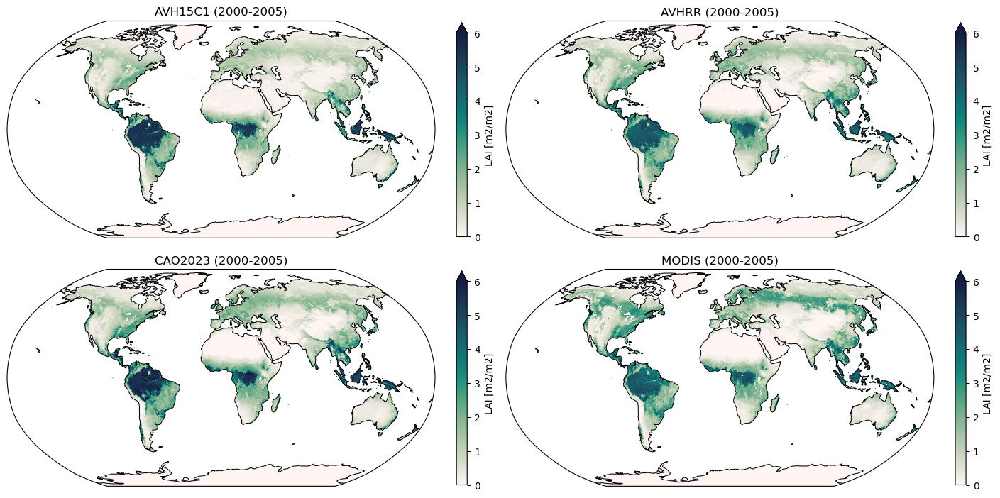

In [14]:
fig, axs = plt.subplots(2, 2, figsize=(14, 7), subplot_kw={'projection': ccrs.Robinson()}, layout='constrained')
ax = axs.flatten()

for i, (name, da) in enumerate(lai_tavg_overlap.items()):
    da.plot(
        ax=ax[i], transform=ccrs.PlateCarree(),
        cbar_kwargs={'fraction': 0.025, 'label': 'LAI [m2/m2]'},
        extend='max',
        cmap=cmo.tempo,
        vmin=0, vmax=6)
    ax[i].set_title(f'{name.upper()} ({start_year}-{end_year})', fontsize=12)
    ax[i].coastlines(lw=0.75)

## 3.2. ET

In [15]:
print(f'{start_year} to {end_year}')

ilat = et['GLEAM'].lat.values  # use the lat values from GLEAM for interpolation

et_savg = {}
et_zavg = {}
et_izavg = {}

# Full temporal averages (all years for each dataset)
et_tavg_full = {}
et_tzavg_full = {}
et_itzavg_full = {}

# Temporal averages for the specified year range (overlapping time period only)
et_tavg_overlap = {}
et_tzavg_overlap = {}
et_itzavg_overlap = {}

for key in et.keys():
    # Compute the global average
    et_savg[key] = (et[key] * lnd_area[key]).sum(dim=['lat', 'lon']) / lnd_area[key].sum(dim=['lat', 'lon'])

    # Compute the zonal averages
    et_zavg[key] = et[key].mean(dim='lon')

    # Interpolate the zonal average to a 1deg lat grid
    et_izavg[key] = et_zavg[key].interp(lat=ilat, method='linear')

    # Compute the temporal average for the full dataset
    et_tavg_full[key] = et[key].mean(dim='year')
    et_tzavg_full[key] = et_tavg_full[key].mean(dim='lon')
    et_itzavg_full[key] = et_tzavg_full[key].interp(lat=ilat, method='linear')
    
    # Compute the temporal average for the specified year range
    if (start_year in et[key].year) and (end_year in et[key].year):
        et_tavg_overlap[key] = et[key].sel(year=year_slice).mean(dim='year')

        # Compute the temporal and zonal average
        et_tzavg_overlap[key] = et_tavg_overlap[key].mean(dim='lon')
        et_itzavg_overlap[key] = et_tzavg_overlap[key].interp(lat=ilat, method='linear')
    else:
        print('skipping temporal average for', key)

# Create a DataArray from the et_itzavg_overlap dictionary
datasets = list(et_itzavg_overlap.keys())
data = [et_itzavg_overlap[ds].values for ds in datasets]
et_itzavg_overlap_da = xr.DataArray(
    data,
    dims=['dataset', 'lat'],
    coords={'dataset': datasets, 'lat': ilat},
    name='et_itzavg_overlap',
    attrs={
        'units': 'W m-2',
        'standard_name': 'latent_heat_flux',
        'long_name': 'latent heat flux',
    }
)

2000 to 2005
skipping temporal average for CLASS
skipping temporal average for WECANN


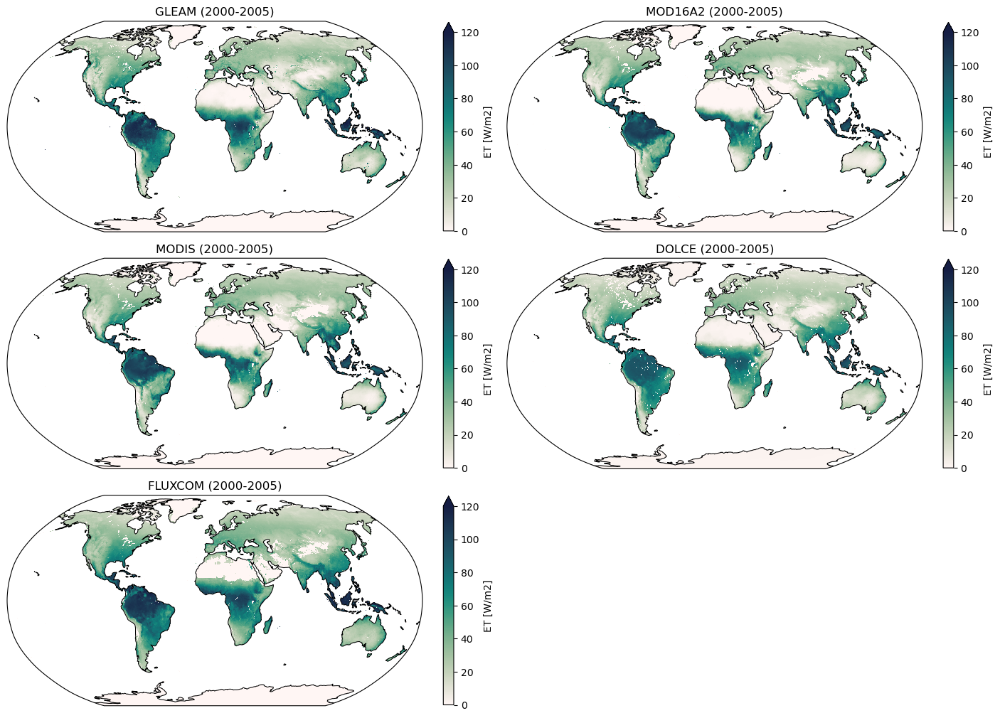

In [25]:
fig, axs = plt.subplots(3, 2, figsize=(14, 10), subplot_kw={'projection': ccrs.Robinson()}, layout='constrained')
ax = axs.flatten()

for i, (name, da) in enumerate(et_tavg_overlap.items()):
    da.plot(
        ax=ax[i], transform=ccrs.PlateCarree(),
        cbar_kwargs={'fraction': 0.025, 'label': 'ET [W/m2]'},
        extend='max',
        cmap=cmo.tempo,
        vmin=0, vmax=120)
    ax[i].set_title(f'{name.upper()} ({start_year}-{end_year})', fontsize=12)
    ax[i].coastlines(lw=0.75)

ax[-1].remove()

# 4. Load model output

In [20]:
# default simulation of historical prescribed-SST PPE
hist_dir = "/glade/derecho/scratch/bbuchovecky/archive"
hist_case = "f.e22.FHIST_BGC.f19_f17_mg17.coupPPE-hist.000"

# 3 member ensemble of historical prescribed-SST CMIP simulations
cmip_dir = "/glade/campaign/collections/cmip/CMIP6/timeseries-cmip6"
cmip_case = "f.e21.FHIST_BGC.f19_f19_mg17.CMIP6-AMIP-2deg"

# default simulation of preindustrial slab ocean PPE (Claire's PPE)
piso_dir = "/glade/campaign/cgd/tss/czarakas/CoupledPPE/coupled_simulations"
piso_case = "COUP0000_PI_SOM"

In [120]:
variables = {
    "atm": ["LHFLX"],
    "lnd": ["TLAI", "FGEV", "FCTR", "FCEV", "EFLX_LH_TOT"],
}

model_start_year = 1950
model_end_year = 2014
times = np.array([cftime.DatetimeNoLeap(year, month, 1)
                  for year in range(model_start_year, model_end_year + 1)
                  for month in range(1, 13)])

cmip = dict()
hist = dict()
piso = dict()

for comp, vars in variables.items():
    for v in vars:
        print(v)

        hist[v] = xr.open_mfdataset(f"{hist_dir}/{hist_case}/{comp}/proc/tseries/month_1/*h0*.{v}.*.nc")[v].sel(time=slice("1950-01", "2015-01"))
        assert len(times) == hist[v].sizes["time"]
        hist[v] = hist[v].assign_coords(time=times)
        if comp == "lnd":
            hist[v] = hist[v].reindex_like(hist[variables["atm"][0]], method="nearest", tolerance=1e-3)

        if glob(f"{piso_dir}/{piso_case}/{comp}/proc/tseries/*h0*{v}.nc"):
            piso[v] = xr.open_mfdataset(f"{piso_dir}/{piso_case}/{comp}/proc/tseries/*h0*{v}.nc")[v].sel(time=slice("0100-01", "0188-12")).reindex(lat=hist[variables["atm"][0]].lat, lon=hist[variables["atm"][0]].lon, method="nearest", tolerance=1e-3)
            if comp == "lnd":
                piso[v] = piso[v].reindex(lat=hist[variables["atm"][0]].lat, lon=hist[variables["atm"][0]].lon, method="nearest", tolerance=1e-3)
        
        cmip_list = []
        for i in range(3):
            cmip_tmp = xr.open_mfdataset(f"{cmip_dir}/{cmip_case}.00{i+1}/{comp}/proc/tseries/month_1/*h0*.{v}.*.nc")[v].sel(time=slice("1950-01", "2015-01"))
            assert len(times) == cmip_tmp.sizes["time"]
            cmip_tmp = cmip_tmp.assign_coords(time=times)
            cmip_list.append(cmip_tmp.reindex_like(hist[v], method="nearest", tolerance=1e-3))
        cmip[v] = cmip_list
    
cmip_tmp = xr.open_mfdataset(f"{cmip_dir}/{cmip_case}.001/lnd/proc/tseries/month_1/*h1*.HTOP.*.nc").isel(time=0).reindex_like(hist[variables["atm"][0]], method="nearest", tolerance=1e-3)
cmip["landarea"] = cmip_tmp["area"] * cmip_tmp["landfrac"]
cmip["landweights"] = cmip["landarea"] / cmip["landarea"].sum(dim=["lat", "lon"])

hist_tmp = xr.open_mfdataset(f"{hist_dir}/{hist_case}/lnd/proc/tseries/month_1/*h1*.HTOP.*.nc").reindex(lat=hist[variables["atm"][0]].lat, lon=hist[variables["atm"][0]].lon, method="nearest", tolerance=1e-3)
hist["landarea"] = hist_tmp["area"] * hist_tmp["landfrac"]
hist["landweights"] = hist["landarea"] / hist["landarea"].sum(dim=["lat", "lon"])

piso["landarea"] = hist["landarea"]
piso["landweights"] = hist["landweights"]

area = xr.open_mfdataset(f"{cmip_dir}/{cmip_case}.001/atm/proc/tseries/month_1/*h0*.AREA.*.nc")["AREA"].isel(time=-1).reindex_like(hist[variables["atm"][0]], method="nearest", tolerance=1e-3)
areaweights = area / area.sum(dim=["lat", "lon"])

cmip["areaweights"] = areaweights
hist["areaweights"] = areaweights
piso["areaweights"] = areaweights

LHFLX
TLAI
FGEV
FCTR
FCEV
EFLX_LH_TOT


In [121]:
cmipa = dict()
for var in cmip.keys():
    print(var)

    if isinstance(cmip[var], list):
        tmp = (cmip[var][0] + cmip[var][1] + cmip[var][2]) / len(cmip[var])
        cmipa[var] = tmp.copy(deep=True)
    else:
        cmipa[var] = cmip[var].copy(deep=True)

LHFLX
TLAI
FGEV
FCTR
FCEV
EFLX_LH_TOT
landarea
landweights
areaweights


In [122]:
def calc_annual_mean(ds, season='annual'):
    ''' Calculate the annual mean of a dataset, optionally for a specific season. '''
    nyears = len(ds.groupby('time.year'))
    month_length = ds.time.dt.days_in_month
    if season != 'annual':
        month_length = month_length.where(month_length['time.season'] == season)

    weights = month_length.groupby('time.year') / month_length.groupby('time.year').sum()
    np.testing.assert_allclose(weights.groupby('time.year').sum().values, np.ones(nyears))

    return (ds * weights).groupby('time.year').sum(dim='time')


for comp, vars in variables.items():
    for v in vars:
        hist[v+"_ANN"] = calc_annual_mean(hist[v])
        cmipa[v+"_ANN"] = calc_annual_mean(cmipa[v])
        piso[v+"_ANN"] = calc_annual_mean(piso[v])

        hist[v+"_TAVG"] = hist[v+"_ANN"].sel(year=year_slice).mean(dim="year")
        cmipa[v+"_TAVG"] = cmipa[v+"_ANN"].sel(year=year_slice).mean(dim="year")
        piso[v+"_TAVG"] = piso[v+"_ANN"].mean(dim="year")

# 5. LAI model-obs comparison

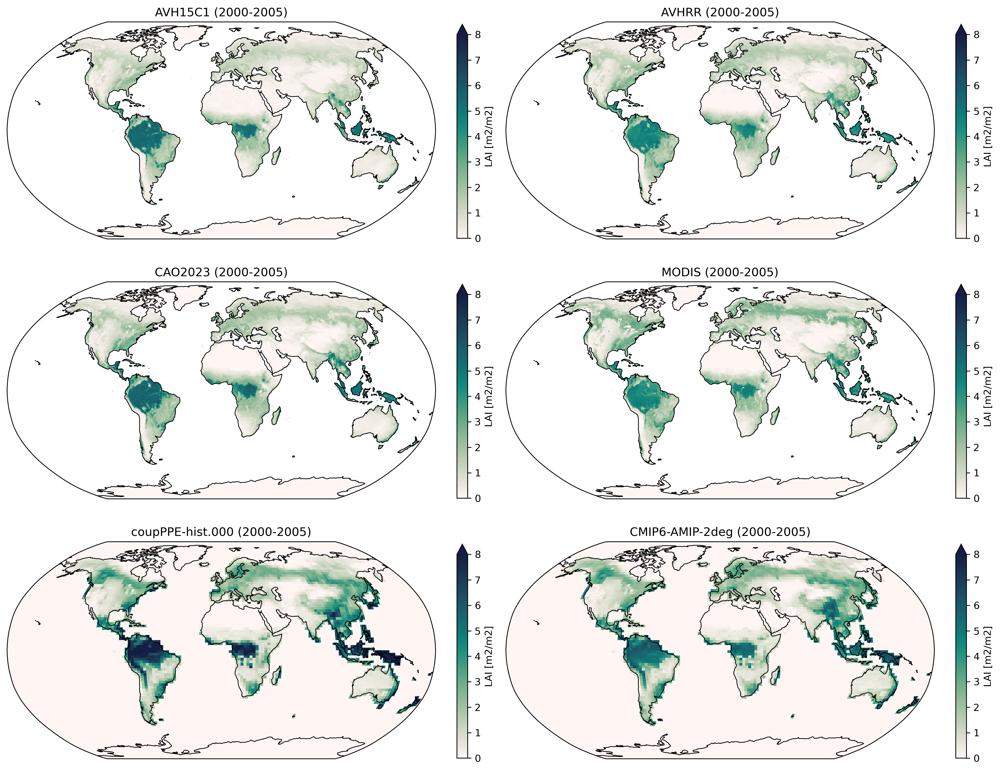

In [ ]:
fig, axs = plt.subplots(3, 2, figsize=(14, 11), subplot_kw={'projection': ccrs.Robinson()}, layout='constrained', dpi=300)
ax = axs.flatten()

vmin = 0
vmax = 8

for i, (name, da) in enumerate(lai_tavg_overlap.items()):
    da.plot(
        ax=ax[i], transform=ccrs.PlateCarree(),
        cbar_kwargs={'fraction': 0.025, 'label': 'LAI [m2/m2]'},
        extend='max',
        cmap=cmo.tempo,
        vmin=vmin, vmax=vmax,
    )
    ax[i].set_title(f'{name.upper()} ({start_year}-{end_year})', fontsize=12)
    ax[i].coastlines(lw=0.75)

hist["TLAI_TAVG"].plot(
    ax=ax[4], transform=ccrs.PlateCarree(),
    cbar_kwargs={'fraction': 0.025, 'label': 'LAI [m2/m2]'},
    extend='max',
    cmap=cmo.tempo,
    vmin=vmin, vmax=vmax,
)
ax[4].set_title(f"coupPPE-hist.000 ({start_year}-{end_year})")
ax[4].coastlines(lw=0.75)

cmipa["TLAI_TAVG"].plot(
    ax=ax[5], transform=ccrs.PlateCarree(),
    cbar_kwargs={'fraction': 0.025, 'label': 'LAI [m2/m2]'},
    extend='max',
    cmap=cmo.tempo,
    vmin=vmin, vmax=vmax,
)
ax[5].set_title(f"CMIP6-AMIP-2deg ({start_year}-{end_year})")
ax[5].coastlines(lw=0.75)

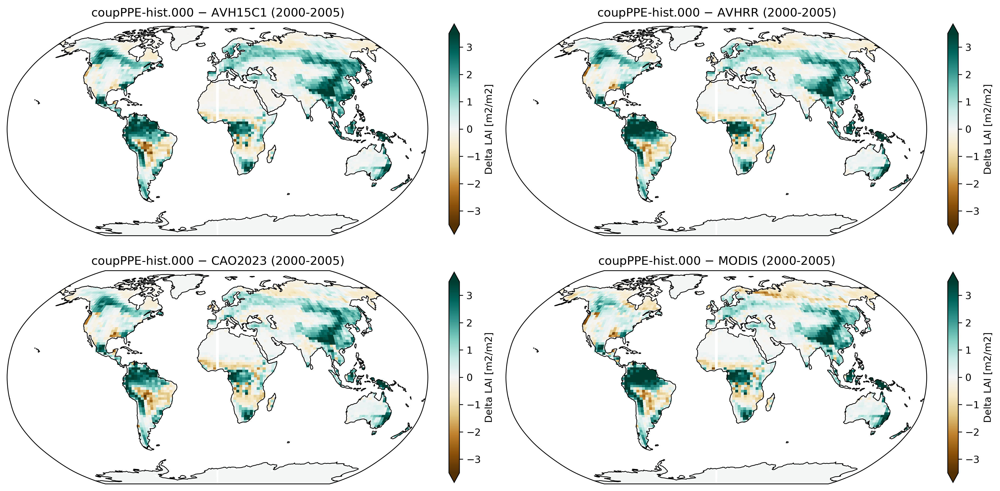

In [124]:
fig, axs = plt.subplots(2, 2, figsize=(14, 7), subplot_kw={'projection': ccrs.Robinson()}, layout='constrained', dpi=300)
ax = axs.flatten()

obs_dict = lai_tavg_overlap
model_da = hist["TLAI_TAVG"]
model_key = "coupPPE-hist.000"

for i, (obs_key, obs_da) in enumerate(obs_dict.items()):
    iobs_da = obs_da.assign_coords(lon=(obs_da.lon % 360)).sortby('lon')
    iobs_da = iobs_da.interp_like(model_da)
    (model_da - iobs_da).plot(
        ax=ax[i], transform=ccrs.PlateCarree(),
        cbar_kwargs={'fraction': 0.025, 'label': 'Delta LAI [m2/m2]'},
        extend='both',
        cmap="BrBG",
        vmin=-3.5, vmax=3.5,
    )
    ax[i].set_title(f'{model_key} $-$ {obs_key} ({start_year}-{end_year})', fontsize=12)
    ax[i].coastlines(lw=0.75)

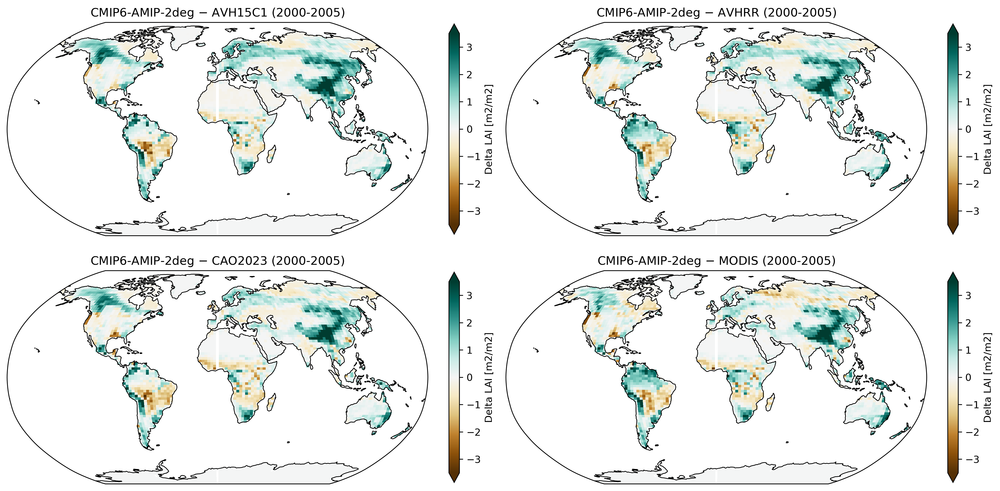

In [125]:
fig, axs = plt.subplots(2, 2, figsize=(14, 7), subplot_kw={'projection': ccrs.Robinson()}, layout='constrained', dpi=300)
ax = axs.flatten()

obs_dict = lai_tavg_overlap
model_da = cmipa["TLAI_TAVG"]
model_key = "CMIP6-AMIP-2deg"

for i, (obs_key, obs_da) in enumerate(obs_dict.items()):
    iobs_da = obs_da.assign_coords(lon=(obs_da.lon % 360)).sortby('lon')
    iobs_da = iobs_da.interp_like(model_da)
    (model_da - iobs_da).plot(
        ax=ax[i], transform=ccrs.PlateCarree(),
        cbar_kwargs={'fraction': 0.025, 'label': 'Delta LAI [m2/m2]'},
        extend='both',
        cmap="BrBG",
        vmin=-3.5, vmax=3.5,
    )
    ax[i].set_title(f'{model_key} $-$ {obs_key} ({start_year}-{end_year})', fontsize=12)
    ax[i].coastlines(lw=0.75)

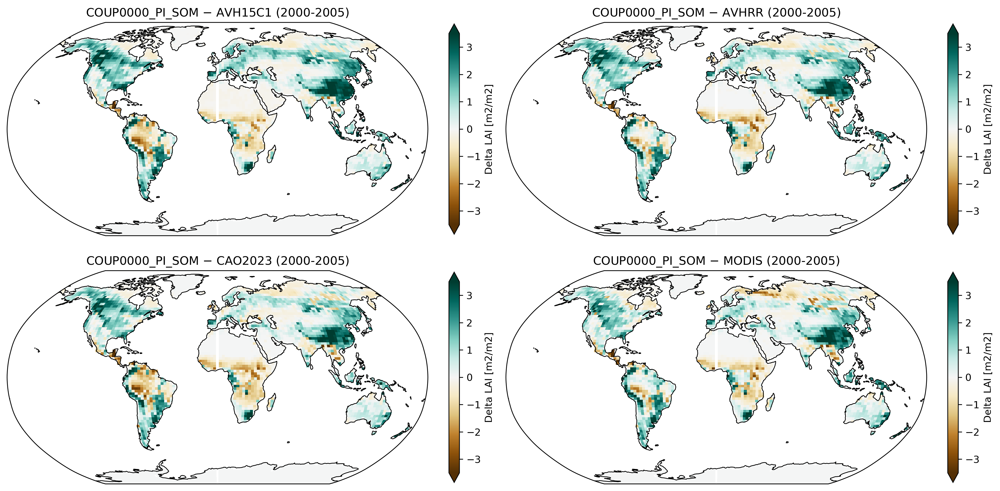

In [148]:
fig, axs = plt.subplots(2, 2, figsize=(14, 7), subplot_kw={'projection': ccrs.Robinson()}, layout='constrained', dpi=300)
ax = axs.flatten()

obs_dict = lai_tavg_overlap
model_da = piso["TLAI_TAVG"]
model_key = "COUP0000_PI_SOM"

for i, (obs_key, obs_da) in enumerate(obs_dict.items()):
    iobs_da = obs_da.assign_coords(lon=(obs_da.lon % 360)).sortby('lon')
    iobs_da = iobs_da.interp_like(model_da)
    (model_da - iobs_da).plot(
        ax=ax[i], transform=ccrs.PlateCarree(),
        cbar_kwargs={'fraction': 0.025, 'label': 'Delta LAI [m2/m2]'},
        extend='both',
        cmap="BrBG",
        vmin=-3.5, vmax=3.5,
    )
    ax[i].set_title(f'{model_key} $-$ {obs_key} ({start_year}-{end_year})', fontsize=12)
    ax[i].coastlines(lw=0.75)

Text(0.5, 1.0, 'CMIP6-AMIP-2deg (2000-2005)')

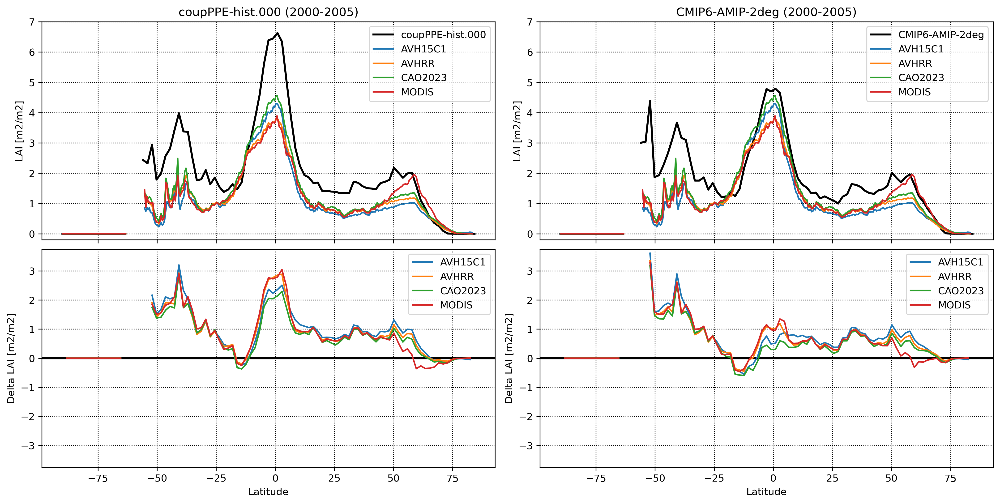

In [147]:
fig, axs = plt.subplots(2, 2, figsize=(14, 7), sharex=True, layout='constrained', dpi=300)
ax = axs.flatten()

model_dict = {
    "coupPPE-hist.000": hist["TLAI_TAVG"],
    "CMIP6-AMIP-2deg": cmipa["TLAI_TAVG"],
}
obs_dict = lai_tavg_overlap

for j, (model_key, model_da) in enumerate(model_dict.items()):
    axs[0, j].plot(model_da.lat, model_da.where(hist["landarea"]>0).mean(dim="lon"), c="k", lw=2, label=model_key)

    for i, (obs_key, obs_da) in enumerate(obs_dict.items()):
        axs[0, j].plot(obs_da.lat, obs_da.where(lnd_area[obs_key]>0).mean(dim="lon"), label=obs_key)

        iobs_da = obs_da.where(lnd_area[obs_key]>0).assign_coords(lon=(obs_da.lon % 360)).sortby('lon')
        iobs_da = iobs_da.interp_like(model_da)
        axs[1, j].plot(
            iobs_da.lat, 
            model_da.where(hist["landarea"]>0).mean(dim="lon") - iobs_da.mean(dim="lon"),
            label=obs_key,
        )

    axs[0, j].legend()
    axs[0, j].grid(lw=0.8, ls=":", color="k")
    
    axs[1, j].legend()
    axs[1, j].grid(lw=0.8, ls=":", color="k")

    axs[0, j].set_ylabel("LAI [m2/m2]")
    axs[0, j].set_ylim(-0.2, 7)

    axs[1, j].set_ylabel("Delta LAI [m2/m2]")
    axs[1, j].set_ylim(-3.75, 3.75)
    axs[1, j].axhline(0, c="k", lw=2, zorder=0)

axs[1, 0].set_xlabel("Latitude")
axs[1, 1].set_xlabel("Latitude")

ax[0].set_title(f"coupPPE-hist.000 ({start_year}-{end_year})")
ax[1].set_title(f"CMIP6-AMIP-2deg ({start_year}-{end_year})")

Text(0.5, 1.0, 'COUP0000_PI_SOM (obs: 2000-2005)')

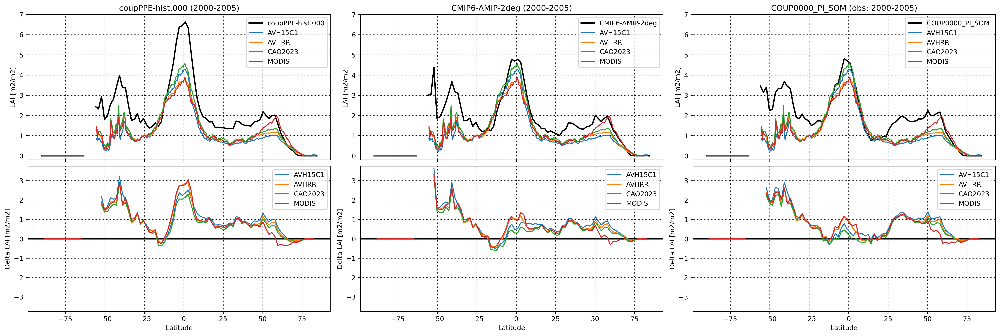

In [149]:
fig, axs = plt.subplots(2, 3, figsize=(21, 7), sharex=True, layout='constrained', dpi=300)
ax = axs.flatten()

model_dict = {
    "coupPPE-hist.000": hist["TLAI_TAVG"],
    "CMIP6-AMIP-2deg": cmipa["TLAI_TAVG"],
    "COUP0000_PI_SOM": piso["TLAI_TAVG"],
}

obs_dict = lai_tavg_overlap

for j, (model_key, model_da) in enumerate(model_dict.items()):
    axs[0, j].plot(model_da.lat, model_da.where(hist["landarea"]>0).mean(dim="lon"), c="k", lw=2, label=model_key)

    for i, (obs_key, obs_da) in enumerate(obs_dict.items()):
        axs[0, j].plot(obs_da.lat, obs_da.where(lnd_area[obs_key]>0).mean(dim="lon"), label=obs_key)

        iobs_da = obs_da.where(lnd_area[obs_key]>0).assign_coords(lon=(obs_da.lon % 360)).sortby('lon')
        iobs_da = iobs_da.interp_like(model_da)
        axs[1, j].plot(
            iobs_da.lat, 
            model_da.where(hist["landarea"]>0).mean(dim="lon") - iobs_da.mean(dim="lon"),
            label=obs_key,
        )

    axs[0, j].legend()
    axs[0, j].grid(lw=0.8, ls=":", color="k")
    
    axs[1, j].legend()
    axs[1, j].grid(lw=0.8, ls=":", color="k")

    axs[0, j].set_ylabel("LAI [m2/m2]")
    axs[0, j].set_ylim(-0.2, 7)

    axs[1, j].set_ylabel("Delta LAI [m2/m2]")
    axs[1, j].set_ylim(-3.75, 3.75)
    axs[1, j].axhline(0, c="k", lw=2, zorder=0)

axs[1, 0].set_xlabel("Latitude")
axs[1, 1].set_xlabel("Latitude")
axs[1, 2].set_xlabel("Latitude")

ax[0].set_title(f"coupPPE-hist.000 ({start_year}-{end_year})")
ax[1].set_title(f"CMIP6-AMIP-2deg ({start_year}-{end_year})")
ax[2].set_title(f"COUP0000_PI_SOM (obs: {start_year}-{end_year})")

# 6. ET model-obs comparison

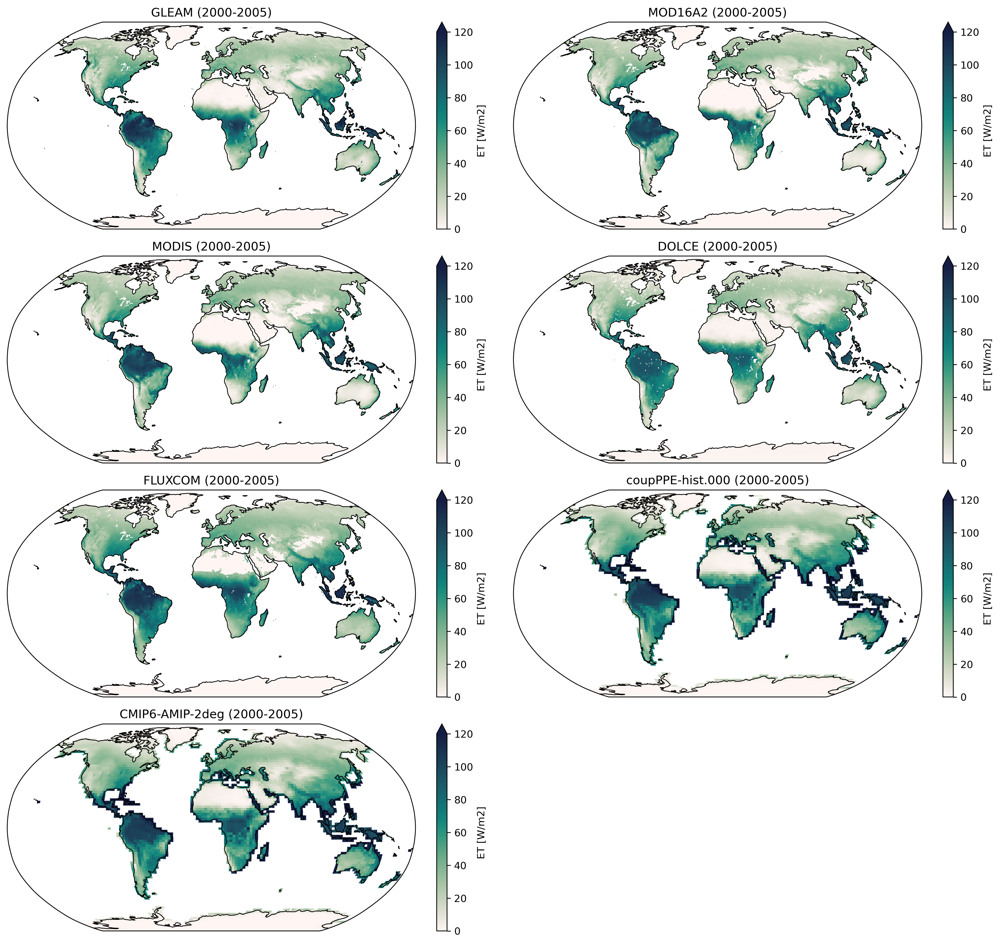

In [27]:
fig, axs = plt.subplots(4, 2, figsize=(14, 13), subplot_kw={'projection': ccrs.Robinson()}, layout='constrained', dpi=300)
ax = axs.flatten()

vmin = 0
vmax = 120

for i, (name, da) in enumerate(et_tavg_overlap.items()):
    da.plot(
        ax=ax[i], transform=ccrs.PlateCarree(),
        cbar_kwargs={'fraction': 0.025, 'label': 'ET [W/m2]'},
        extend='max',
        cmap=cmo.tempo,
        vmin=vmin, vmax=vmax,
    )
    ax[i].set_title(f'{name.upper()} ({start_year}-{end_year})', fontsize=12)
    ax[i].coastlines(lw=0.75)

hist["LHFLX_TAVG"].where(hist["landarea"]>0).plot(
    ax=ax[5], transform=ccrs.PlateCarree(),
    cbar_kwargs={'fraction': 0.025, 'label': 'ET [W/m2]'},
    extend='max',
    cmap=cmo.tempo,
    vmin=vmin, vmax=vmax,
)
ax[5].set_title(f"coupPPE-hist.000 ({start_year}-{end_year})")
ax[5].coastlines(lw=0.75)

cmipa["LHFLX_TAVG"].where(cmipa["landarea"]>0).plot(
    ax=ax[6], transform=ccrs.PlateCarree(),
    cbar_kwargs={'fraction': 0.025, 'label': 'ET [W/m2]'},
    extend='max',
    cmap=cmo.tempo,
    vmin=vmin, vmax=vmax,
)
ax[6].set_title(f"CMIP6-AMIP-2deg ({start_year}-{end_year})")
ax[6].coastlines(lw=0.75)

ax[-1].remove()

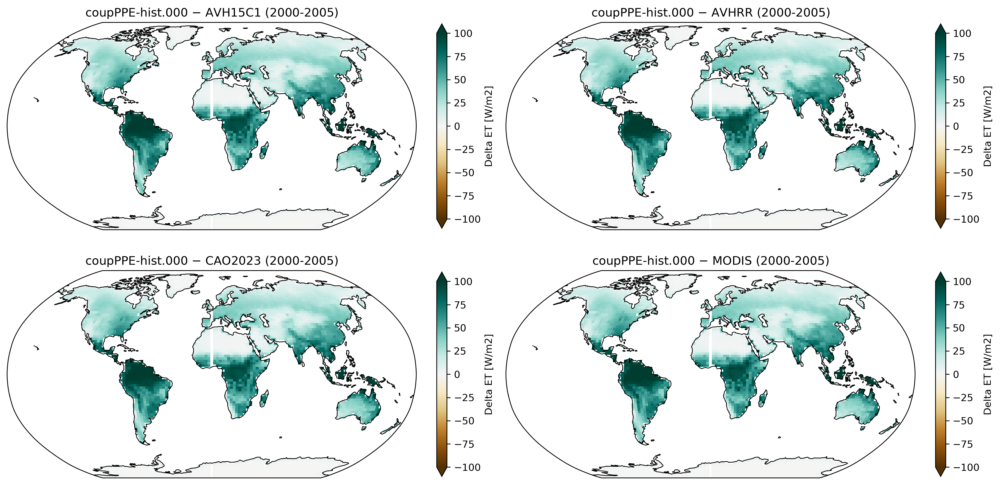

In [32]:
fig, axs = plt.subplots(2, 2, figsize=(14, 7), subplot_kw={'projection': ccrs.Robinson()}, layout='constrained', dpi=300)
ax = axs.flatten()

obs_dict = lai_tavg_overlap
model_da = hist["LHFLX_TAVG"]
model_key = "coupPPE-hist.000"

for i, (obs_key, obs_da) in enumerate(obs_dict.items()):
    iobs_da = obs_da.assign_coords(lon=(obs_da.lon % 360)).sortby('lon')
    iobs_da = iobs_da.interp_like(model_da)
    (model_da - iobs_da).plot(
        ax=ax[i], transform=ccrs.PlateCarree(),
        cbar_kwargs={'fraction': 0.025, 'label': 'Delta ET [W/m2]'},
        extend='both',
        cmap="BrBG",
        vmin=-100, vmax=100,
    )
    ax[i].set_title(f'{model_key} $-$ {obs_key} ({start_year}-{end_year})', fontsize=12)
    ax[i].coastlines(lw=0.75)

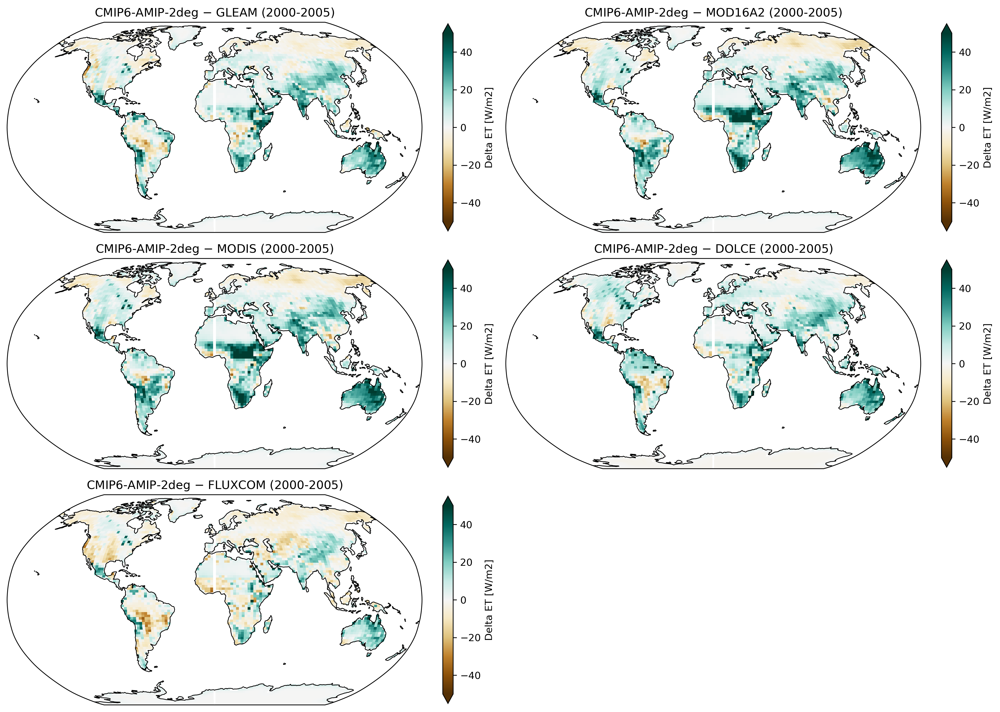

In [45]:
fig, axs = plt.subplots(3, 2, figsize=(14, 10), subplot_kw={'projection': ccrs.Robinson()}, layout='constrained', dpi=300)
ax = axs.flatten()

obs_dict = et_tavg_overlap
model_da = hist["LHFLX_TAVG"]
model_key = "CMIP6-AMIP-2deg"

for i, (obs_key, obs_da) in enumerate(obs_dict.items()):
    iobs_da = obs_da.assign_coords(lon=(obs_da.lon % 360)).sortby('lon')
    iobs_da = iobs_da.interp_like(model_da)
    (model_da - iobs_da).plot(
        ax=ax[i], transform=ccrs.PlateCarree(),
        cbar_kwargs={'fraction': 0.025, 'label': 'Delta ET [W/m2]'},
        extend='both',
        cmap="BrBG",
        vmin=-50, vmax=50,
    )
    ax[i].set_title(f'{model_key} $-$ {obs_key} ({start_year}-{end_year})', fontsize=12)
    ax[i].coastlines(lw=0.75)

ax[-1].remove()

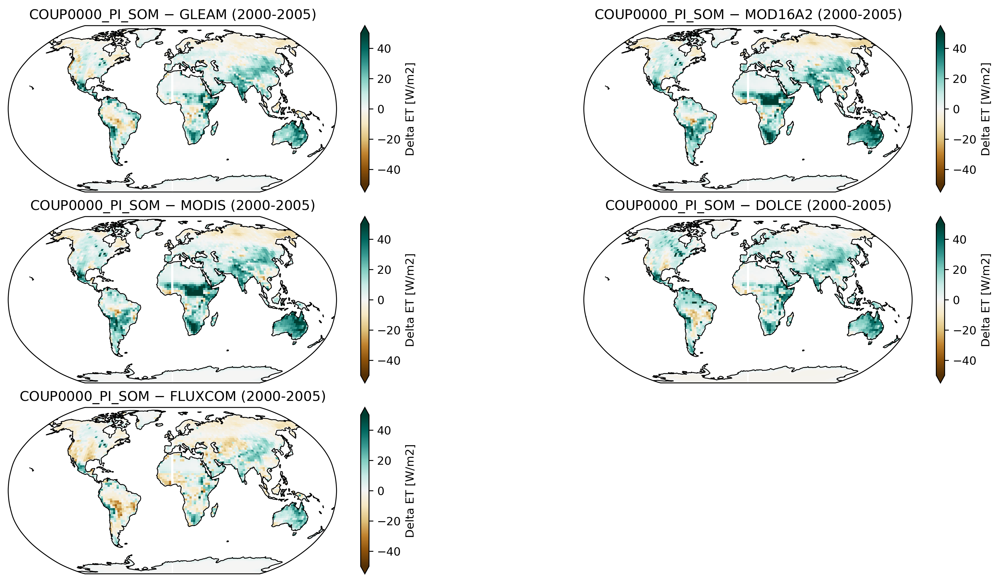

In [46]:
fig, axs = plt.subplots(3, 2, figsize=(14, 7), subplot_kw={'projection': ccrs.Robinson()}, layout='constrained', dpi=300)
ax = axs.flatten()

obs_dict = et_tavg_overlap
model_da = hist["LHFLX_TAVG"]
model_key = "COUP0000_PI_SOM"

for i, (obs_key, obs_da) in enumerate(obs_dict.items()):
    iobs_da = obs_da.assign_coords(lon=(obs_da.lon % 360)).sortby('lon')
    iobs_da = iobs_da.interp_like(model_da)
    (model_da - iobs_da).plot(
        ax=ax[i], transform=ccrs.PlateCarree(),
        cbar_kwargs={'fraction': 0.025, 'label': 'Delta ET [W/m2]'},
        extend='both',
        cmap="BrBG",
        vmin=-50, vmax=50,
    )
    ax[i].set_title(f'{model_key} $-$ {obs_key} ({start_year}-{end_year})', fontsize=12)
    ax[i].coastlines(lw=0.75)

ax[-1].remove()

Text(0.5, 1.0, 'CMIP6-AMIP-2deg (2000-2005)')

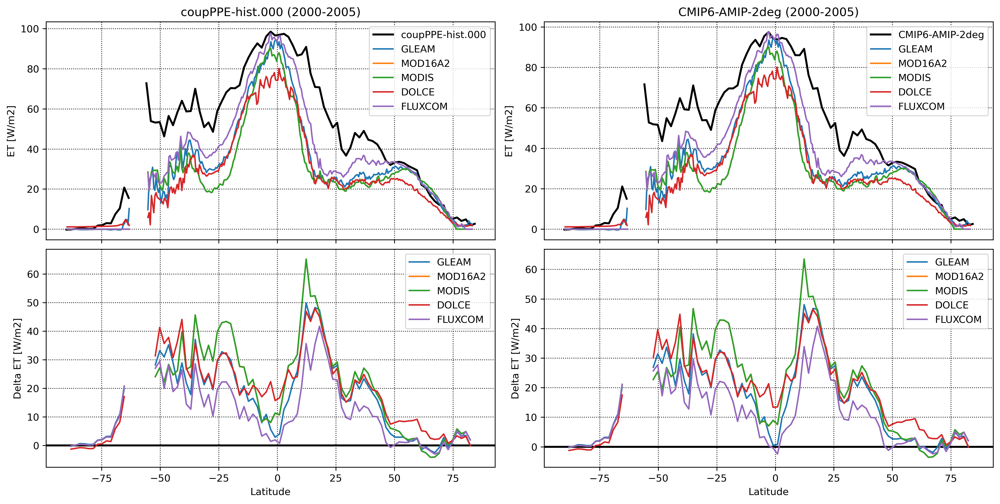

In [38]:
fig, axs = plt.subplots(2, 2, figsize=(14, 7), sharex=True, layout='constrained', dpi=300)
ax = axs.flatten()

model_dict = {
    "coupPPE-hist.000": hist["LHFLX_TAVG"],
    "CMIP6-AMIP-2deg": cmipa["LHFLX_TAVG"],
}
obs_dict = et_tavg_overlap

for j, (model_key, model_da) in enumerate(model_dict.items()):
    axs[0, j].plot(model_da.lat, model_da.where(hist["landarea"]>0).mean(dim="lon"), c="k", lw=2, label=model_key)

    for i, (obs_key, obs_da) in enumerate(obs_dict.items()):
        axs[0, j].plot(obs_da.lat, obs_da.where(lnd_area[obs_key]>0).mean(dim="lon"), label=obs_key)

        iobs_da = obs_da.where(lnd_area[obs_key]>0).assign_coords(lon=(obs_da.lon % 360)).sortby('lon')
        iobs_da = iobs_da.interp_like(model_da)
        axs[1, j].plot(
            iobs_da.lat, 
            model_da.where(hist["landarea"]>0).mean(dim="lon") - iobs_da.mean(dim="lon"),
            label=obs_key,
        )

    axs[0, j].legend()
    axs[0, j].grid(lw=0.8, ls=":", color="k")
    
    axs[1, j].legend()
    axs[1, j].grid(lw=0.8, ls=":", color="k")

    axs[0, j].set_ylabel("ET [W/m2]")
    # axs[0, j].set_ylim(-0.2, 7)

    axs[1, j].set_ylabel("Delta ET [W/m2]")
    # axs[1, j].set_ylim(-3.75, 3.75)
    axs[1, j].axhline(0, c="k", lw=2, zorder=0)

axs[1, 0].set_xlabel("Latitude")
axs[1, 1].set_xlabel("Latitude")

ax[0].set_title(f"coupPPE-hist.000 ({start_year}-{end_year})")
ax[1].set_title(f"CMIP6-AMIP-2deg ({start_year}-{end_year})")

# 7. Intermodel comparison

In [154]:
def plot_intermodel_comparison(model_dict, varname, ylim, vlim, units=None, cmap="BrBG"):
    """Plot the difference map and zonal mean difference."""
    fig, axs = plt.subplots(1, 2, width_ratios=[1, 0.6], figsize=(14, 4.5), layout='constrained', dpi=300)
    ax = axs.flatten()

    ax[0].remove()
    ax[0] = fig.add_subplot(1, 2, 1, projection=ccrs.Robinson())

    model1 = list(model_dict.keys())[0]
    model2 = list(model_dict.keys())[1]

    (model_dict[model1] - model_dict[model2]).plot(
        ax=ax[0],
        transform=ccrs.PlateCarree(),
        vmin=-vlim, vmax=vlim,
        cmap="BrBG",
        extend="both",
        cbar_kwargs={
            "fraction": 0.025,
            "location": "left",
            "label": f"Delta {varname} [{units}]"}
    )
    ax[0].coastlines(lw=0.8, color="k")
    ax[0].set_title(None)

    (model_dict[model1].mean(dim="lon") - model_dict[model2].mean(dim="lon")).plot(ax=ax[1])
    ax[1].axhline(c="k", ls="-", lw=0.8, zorder=0)
    ax[1].set_ylim(-ylim, ylim)
    ax[1].set_xlabel("Latitude")
    ax[1].set_ylabel(f"Delta {varname} [{units}]")
    ax[1].set_title(None)

    fig.suptitle(f"{model1} $-$ {model2} (averaged over {start_year}-{end_year})", x=0.5, ha="center")

    return fig, ax

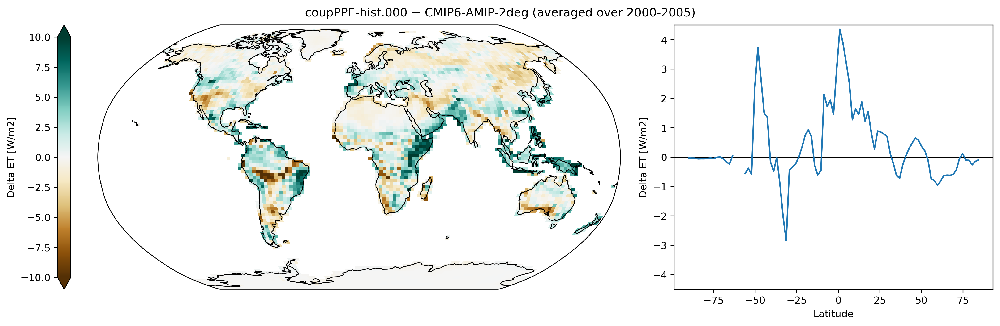

In [155]:
plot_intermodel_comparison(
    {
        "coupPPE-hist.000": hist["EFLX_LH_TOT_TAVG"].where(hist["landarea"]>0),
        "CMIP6-AMIP-2deg": cmipa["EFLX_LH_TOT_TAVG"].where(cmipa["landarea"]>0),
    },
    "ET",
    units="W/m2",
    ylim=4.5,
    vlim=10,
);

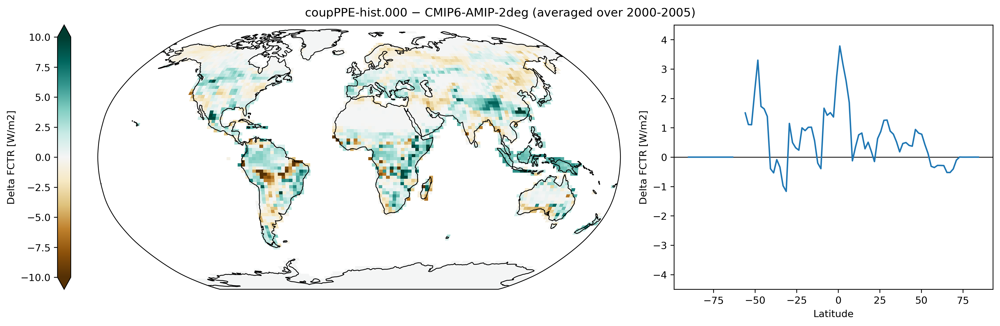

In [156]:
plot_intermodel_comparison(
    {
        "coupPPE-hist.000": hist["FCTR_TAVG"].where(hist["landarea"]>0),
        "CMIP6-AMIP-2deg": cmipa["FCTR_TAVG"].where(cmipa["landarea"]>0),
    },
    "FCTR",
    units="W/m2",
    ylim=4.5,
    vlim=10,
);

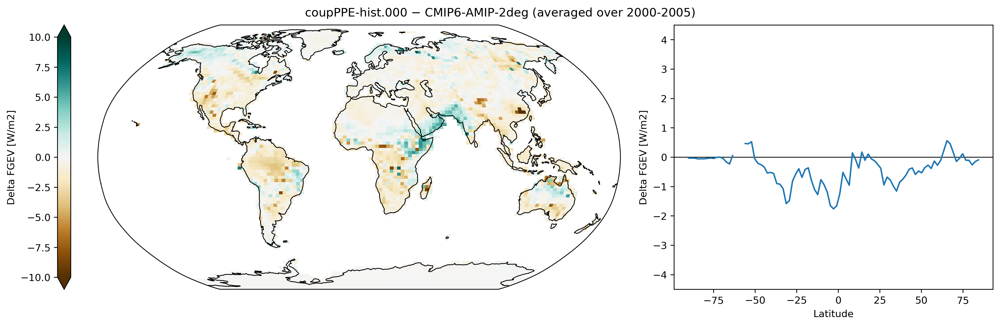

In [157]:
plot_intermodel_comparison(
    {
        "coupPPE-hist.000": hist["FGEV_TAVG"].where(hist["landarea"]>0),
        "CMIP6-AMIP-2deg": cmipa["FGEV_TAVG"].where(cmipa["landarea"]>0),
    },
    "FGEV",
    units="W/m2",
    ylim=4.5,
    vlim=10,
);

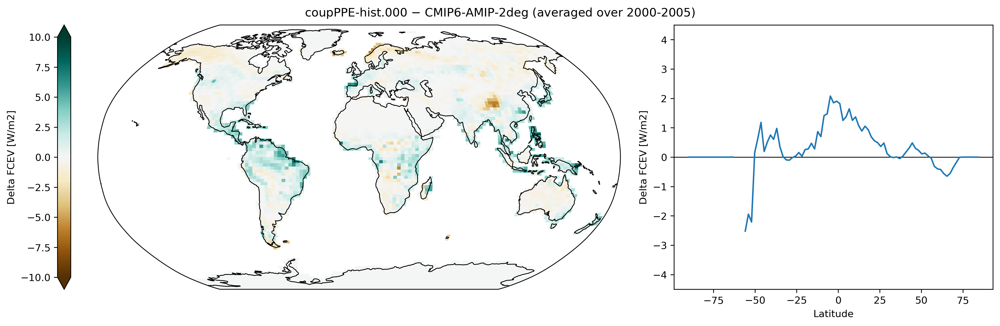

In [158]:
plot_intermodel_comparison(
    {
        "coupPPE-hist.000": hist["FCEV_TAVG"].where(hist["landarea"]>0),
        "CMIP6-AMIP-2deg": cmipa["FCEV_TAVG"].where(cmipa["landarea"]>0),
    },
    "FCEV",
    units="W/m2",
    ylim=4.5,
    vlim=10,
);

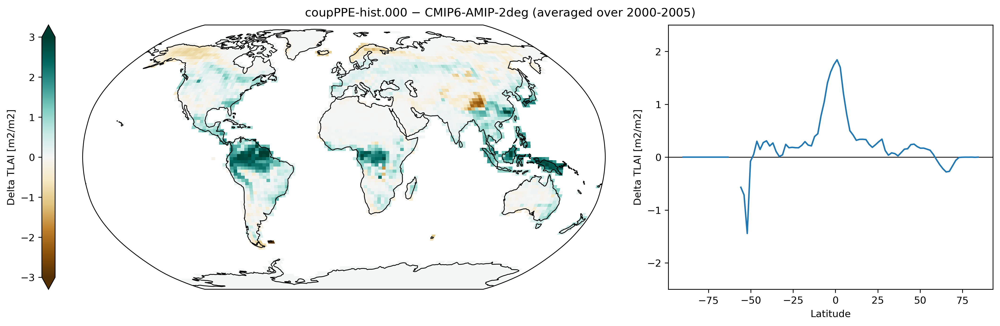

In [159]:
plot_intermodel_comparison(
    {
        "coupPPE-hist.000": hist["TLAI_TAVG"].where(hist["landarea"]>0),
        "CMIP6-AMIP-2deg": cmipa["TLAI_TAVG"].where(cmipa["landarea"]>0),
    },
    "TLAI",
    units="m2/m2",
    ylim=2.5,
    vlim=3,
);